# IMAGE PROCESSING



## Colorspaces
Let's have a brief introduction into converting to different colorspaces! The video goes into more detail about colorspaces.

Quick Info Link: 
https://en.wikipedia.org/wiki/HSL_and_HSV

In [12]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

In [13]:
img = cv2.imread('DATA/00-puppy.jpg')

In [14]:
type(img)

numpy.ndarray

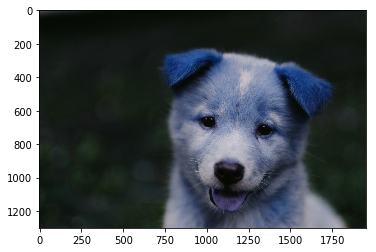

In [15]:
plt.imshow(img)

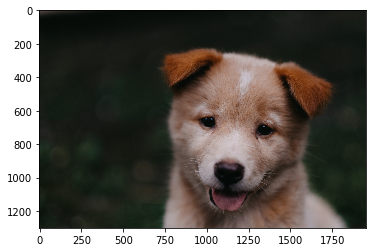

In [16]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

**Converting to HSV**
https://en.wikipedia.org/wiki/HSL_and_HSV

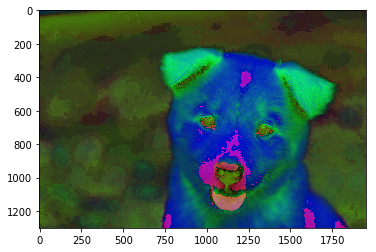

In [17]:
img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
plt.imshow(img)

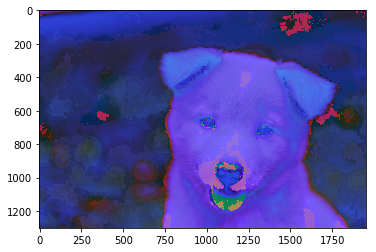

In [18]:
img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
plt.imshow(img)

-----------------

## Blending and Pasting Images


For some computer vision systems, we'll want to be able to post our own image on top of an already existing image or video. We may also want to blend images, maybe we want to have a "highlight" effect instead of just a solid box or empty rectangle.

Let's explore what is commonly known as **Arithmetic Image Operations** with OpenCV. These are referred to as Arithmetic Operations because OpenCV is simply performing some common math with the pixels for the final effect. We'll see a bit of this in our code.


### Blending the Image

Blending Images is actually quite simple, let's look at a simple example.

We will blend the values together with the formula:

$$  img1 * \alpha  + img2 * \beta  + \gamma $$

In [19]:
import cv2

In [21]:
img1 = cv2.imread('DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)


In [22]:
import matplotlib.pyplot as plt
%matplotlib inline

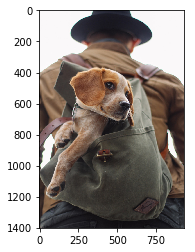

In [26]:
plt.imshow(img1)


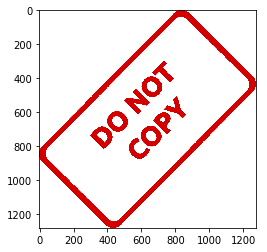

In [27]:
plt.imshow(img2)

In [28]:
img1.shape

(1401, 934, 3)

In [29]:
img2.shape

(1280, 1277, 3)

### Blending Images of the Same Size

In [30]:
img1 = cv2.resize(img1, (1200,1200))
img2 = cv2.resize(img2, (1200,1200))

Let's practice resizing the image, since the DO NOT COPY image is actually quite large 1200 by 1200, and our puppy in backpack image is 1400 by 1000

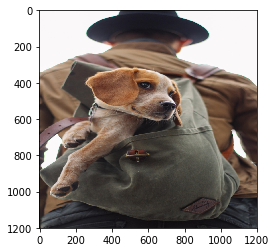

In [31]:
plt.imshow(img1)


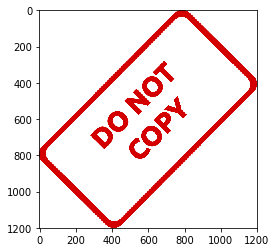

In [32]:
plt.imshow(img2)


In [36]:
blended = cv2.addWeighted(src1 = img1, alpha = 0.8, src2 = img2, beta = 0.2, gamma = 0)

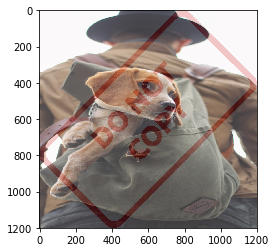

In [37]:
plt.imshow(blended)


### Blending Images of the Different Size

#### Overlay Small Image on Top of Larger Image (No Bending)
We can use this quick trick to quickly overlap different sized images, by simply reassigning the larger image's values to match the smaller image.

In [39]:
# NUMPY REASSIGNMENT

img1 = cv2.imread('DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)


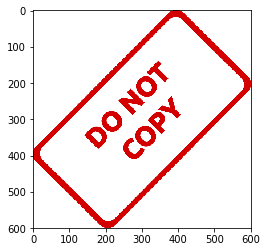

In [40]:
img2 = cv2.resize(img2, (600,600))
plt.imshow(img2)

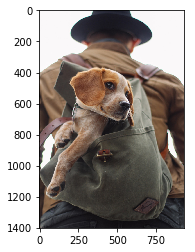

In [41]:
plt.imshow(img1)

In [42]:
large_img = img1
small_img = img2

In [50]:
x_offset = 0
y_offset = 0

In [51]:
x_end = x_offset + small_img.shape[1]
y_end = y_offset + small_img.shape[0]

In [52]:
small_img.shape

(600, 600, 3)

In [53]:
large_img[y_offset:y_end, x_offset:x_end] = small_img

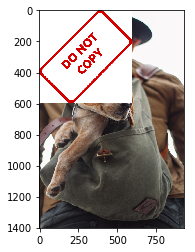

In [54]:
plt.imshow(large_img)

#### Blending Small Image on Top of Larger Image

In [55]:
img1 = cv2.imread('DATA/dog_backpack.png')
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.imread('DATA/watermark_no_copy.png')
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)


In [56]:
img2 = cv2.resize(img2, (600,600))

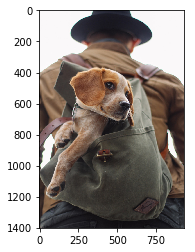

In [57]:
plt.imshow(img1)

***Region Of Interest ===> (600x600 region)***


In [58]:
img1.shape

(1401, 934, 3)

In [59]:
x_offset = 934 - 600
y_offset = 1401 - 600

In [60]:
img2.shape

(600, 600, 3)

In [61]:
r, c, ch = img2.shape

In [62]:
r

600

In [63]:
c

600

In [64]:
ch

3

In [67]:
roi = img1[y_offset:1401, x_offset:934]

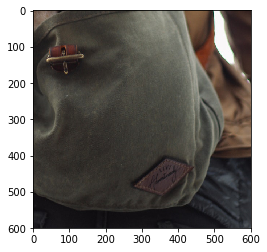

In [68]:
plt.imshow(roi)

***Creating the mask***

In [69]:
img2gray = cv2.cvtColor(img2, cv2.COLOR_RGB2GRAY)

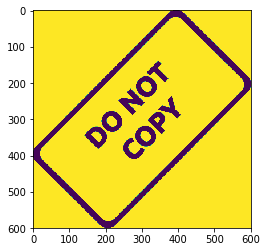

In [70]:
plt.imshow(img2gray)

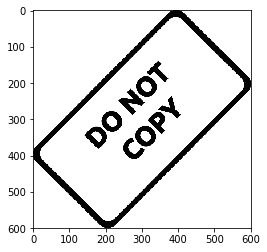

In [71]:
plt.imshow(img2gray, cmap = 'gray')

In [72]:
mask_inv = cv2.bitwise_not(img2gray)

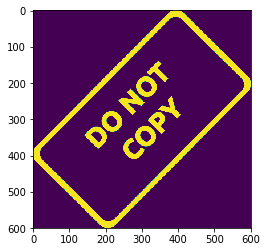

In [73]:
plt.imshow(mask_inv)

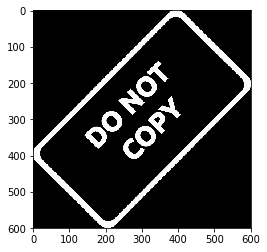

In [74]:
plt.imshow(mask_inv, cmap = 'gray')

In [75]:
mask_inv.shape

(600, 600)

#### Convert Mask to have 3 channels

In [76]:
import numpy as np

In [78]:
white_bg = np.full(img2.shape, 255, dtype = np.uint8)

In [80]:
white_bg.shape

(600, 600, 3)

In [81]:
bk = cv2.bitwise_or(white_bg, white_bg, mask = mask_inv)

In [82]:
bk.shape

(600, 600, 3)

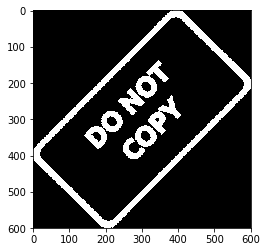

In [83]:
plt.imshow(bk)

#### Grab Original FG image and place on top of Mask

In [84]:
foregd = cv2.bitwise_or(img2, img2, mask = mask_inv)

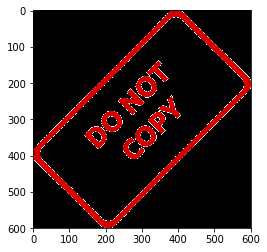

In [85]:
plt.imshow(foregd)

#### Get ROI and blend in the mask with the ROI

In [86]:
fina_roi = cv2.bitwise_or(roi, foregd)

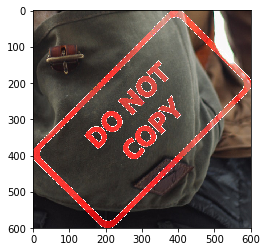

In [87]:
plt.imshow(fina_roi)

#### Now add in the rest of the image

In [88]:
large_img = img1
small_img = fina_roi

In [91]:
large_img[y_offset:y_offset+small_img.shape[0], x_offset:x_offset+small_img.shape[1]] = small_img


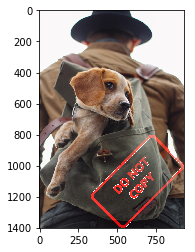

In [92]:
plt.imshow(large_img)

Check out these documentation examples and links for more help for these kinds of tasks (which can be really tricky!)

1. https://stackoverflow.com/questions/10469235/opencv-apply-mask-to-a-color-image/38493075
2. https://stackoverflow.com/questions/14063070/overlay-a-smaller-image-on-a-larger-image-python-opencv
3. https://docs.opencv.org/3.4/d0/d86/tutorial_py_image_arithmetics.html

-----------------

## Image Thresholding

In [138]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [139]:
img = cv2.imread('DATA/rainbow.jpg')

In [140]:
type(img)

numpy.ndarray

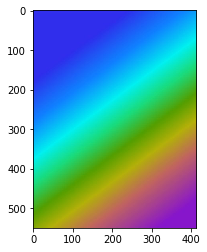

In [141]:
plt.imshow(img)

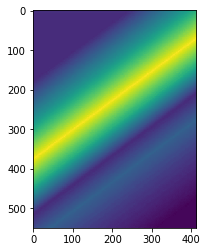

In [142]:
img = cv2.imread('DATA/rainbow.jpg', 0)
plt.imshow(img)

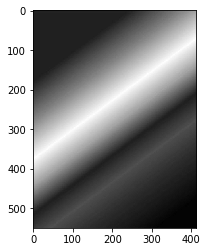

In [143]:
plt.imshow(img, cmap = 'gray')

In [144]:
img.max()

214

### Different Threshold Types

#### Binary

In [145]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)

In [146]:
ret

127.0

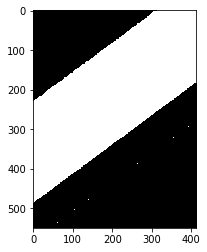

In [147]:
plt.imshow(thresh1, cmap = 'gray')

#### Binary Inverse

In [148]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY_INV)

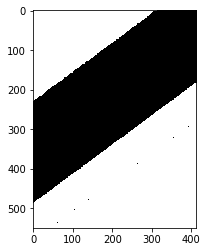

In [149]:
plt.imshow(thresh1, cmap = 'gray')

#### Threshold Truncation

In [150]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_TRUNC)

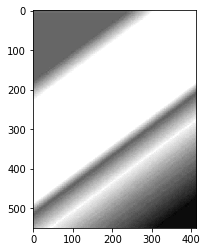

In [151]:
plt.imshow(thresh1, cmap = 'gray')

#### Threshold to Zero

In [152]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO)

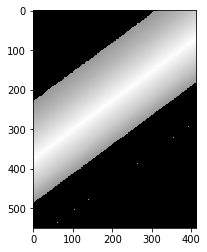

In [153]:
plt.imshow(thresh1, cmap = 'gray')

#### Threshold to Zero (Inverse)

In [154]:
ret, thresh1 = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO_INV)

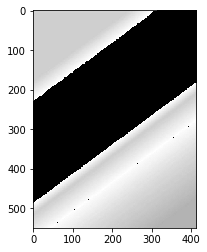

In [155]:
plt.imshow(thresh1, cmap = 'gray')

### Real World Applications

#### Adaptive Thresholding



##### Sudoku Image

In [156]:
img = cv2.imread('DATA/crossword.jpg', 0)


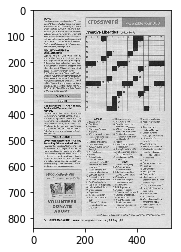

In [157]:
plt.imshow(img, cmap = 'gray')

In [158]:
def show_pic(img):
    fig = plt.figure(figsize = (15,15))
    ax = fig.add_subplot(111)
    ax.imshow(img, cmap = 'gray')

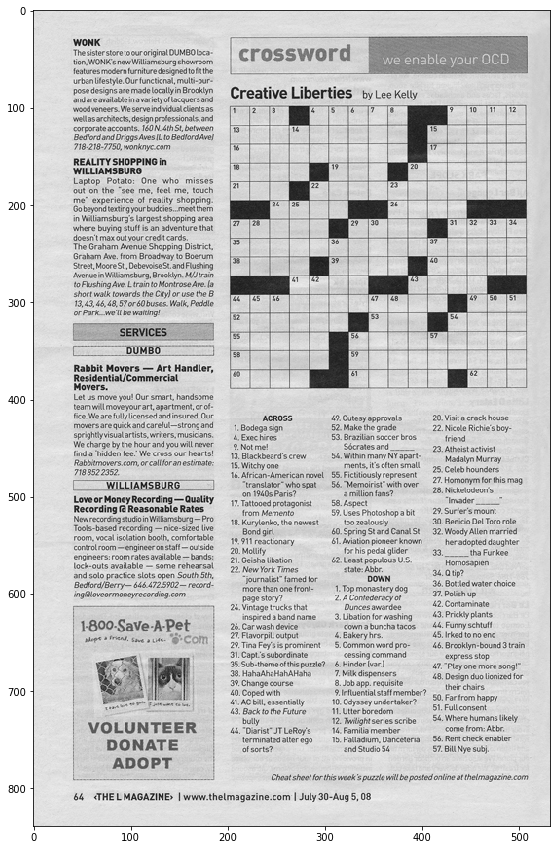

In [159]:
show_pic(img)

#### Simple Binary


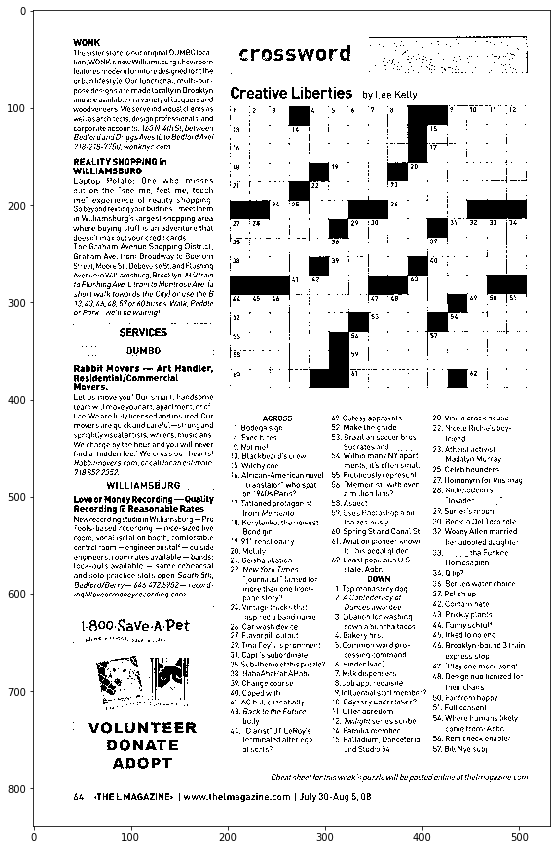

In [160]:
ret, thresh2 = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
show_pic(thresh2)

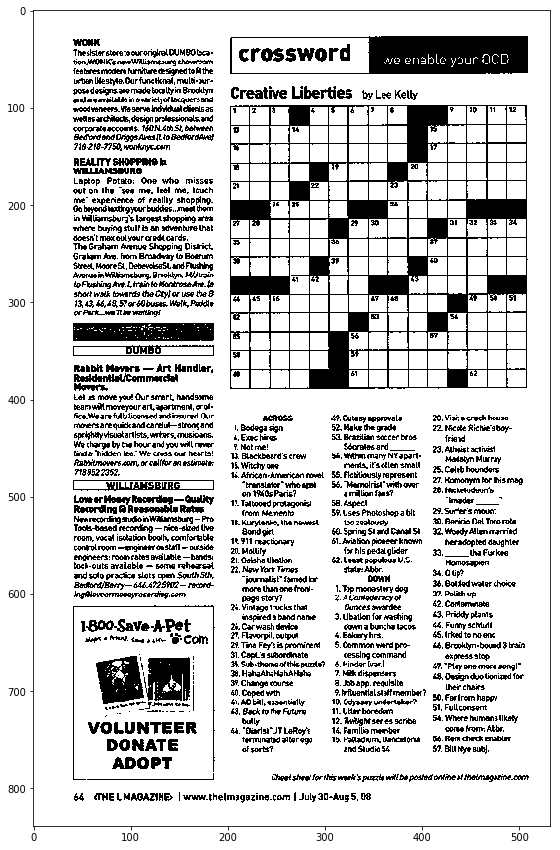

In [161]:
ret, thresh2 = cv2.threshold(img, 180, 255, cv2.THRESH_BINARY)
show_pic(thresh2)

#### Adaptive Threshold

https://stackoverflow.com/questions/28763419/adaptive-threshold-parameters-confusion

    @param src Source 8-bit single-channel image.
    .   @param dst Destination image of the same size and the same type as src.
    .   @param maxValue Non-zero value assigned to the pixels for which the condition is satisfied
    .   @param adaptiveMethod Adaptive thresholding algorithm to use, see #AdaptiveThresholdTypes.
    .   The #BORDER_REPLICATE | #BORDER_ISOLATED is used to process boundaries.
    .   @param thresholdType Thresholding type that must be either #THRESH_BINARY or #THRESH_BINARY_INV,
    .   see #ThresholdTypes.
    .   @param blockSize Size of a pixel neighborhood that is used to calculate a threshold value for the
    .   pixel: 3, 5, 7, and so on.
    .   @param C Constant subtracted from the mean or weighted mean (see the details below). Normally, it
    .   is positive but may be zero or negative as well.

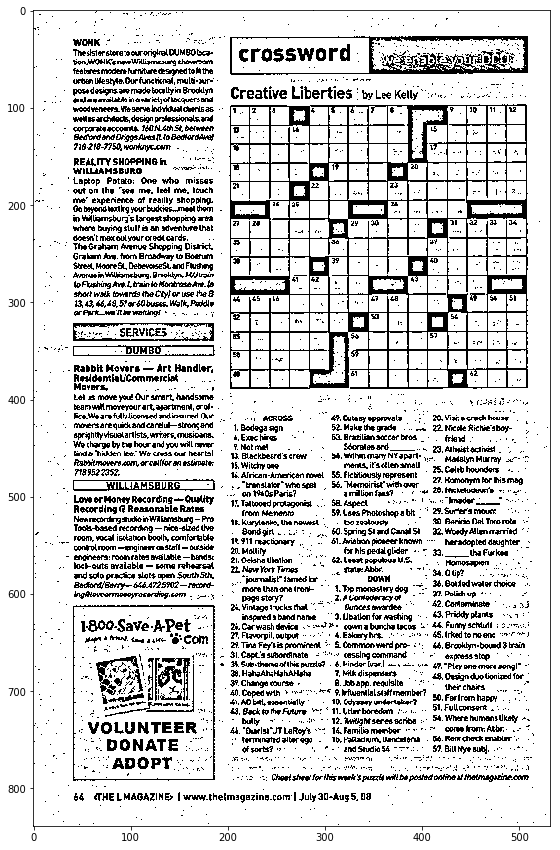

In [162]:
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,8)
show_pic(th2)

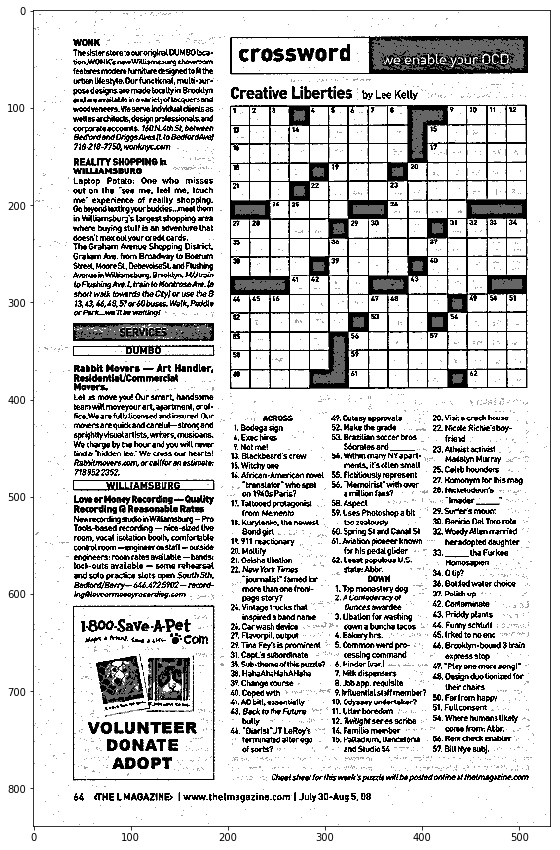

In [163]:
blended = cv2.addWeighted(thresh2, 0.6, th2, 0.4, 0)
show_pic(blended)

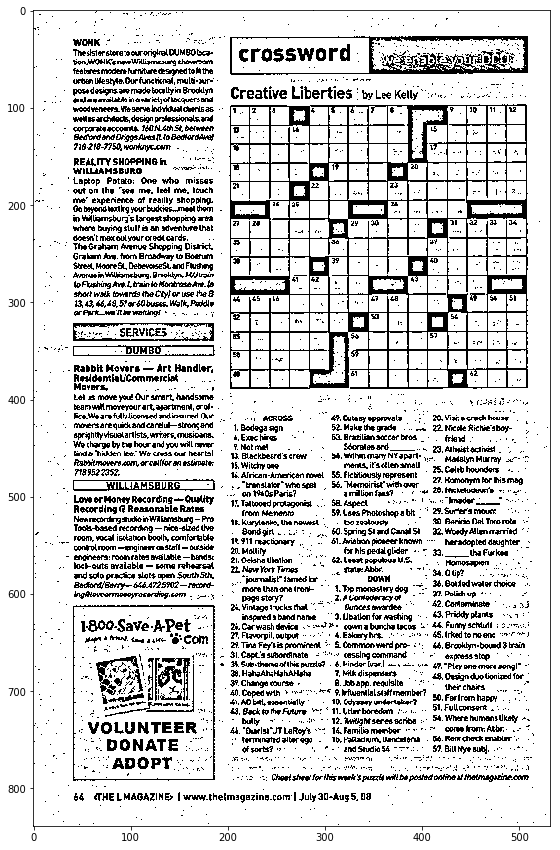

In [164]:
th3 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,8)
show_pic(th2)

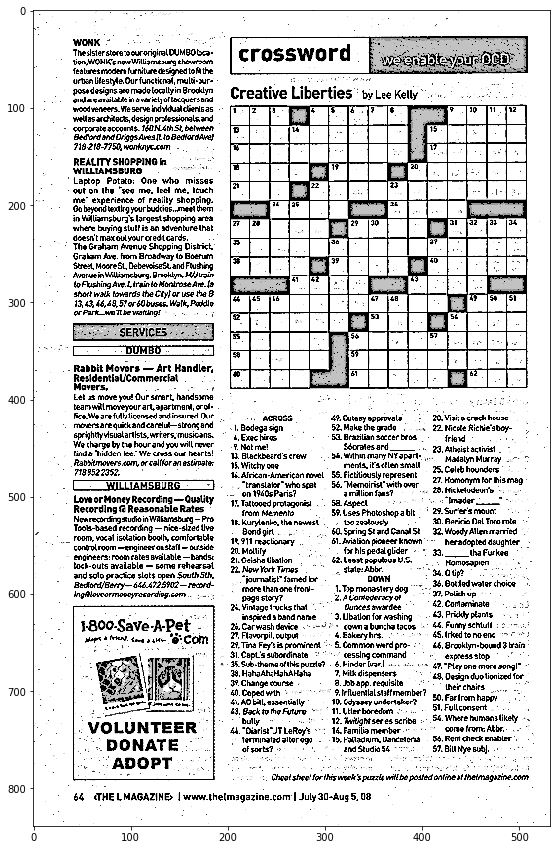

In [165]:
bl1 = cv2.addWeighted(th3, 0.6, blended, 0.4, 0)
show_pic(bl1)

-------------

## Blurring and Smoothing

There are a lot of different effects and filters we can apply to images. We're just going to go through a few of them here. Most of them involve some sort of math based function being applied to all the pixels values.


#### Info Link on Blurring Math:

http://people.csail.mit.edu/sparis/bf_course/


### Convenience Functions

Quick function for loading the puppy image.

In [166]:
import warnings
warnings.filterwarnings('ignore')

In [167]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [168]:
def load_img():
    img = cv2.imread('DATA/bricks.jpg').astype(np.float32) / 255
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

In [169]:
load_img()

array([[[0.7921569 , 0.78431374, 0.8039216 ],
        [0.7529412 , 0.77254903, 0.7882353 ],
        [0.7176471 , 0.76862746, 0.8       ],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.88235295, 0.8784314 , 0.8980392 ],
        [0.75686276, 0.78431374, 0.80784315],
        [0.69803923, 0.75686276, 0.78431374],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.8627451 , 0.8666667 , 0.8862745 ],
        [0.64705884, 0.68235296, 0.70980394],
        [0.48235294, 0.5372549 , 0.57254905],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       ...,

       [[0.8509804 , 0.83137256, 0.84705883],
        [0.84705883, 0.827451  , 0.84313726],
        [0.84313726, 0

In [170]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img)

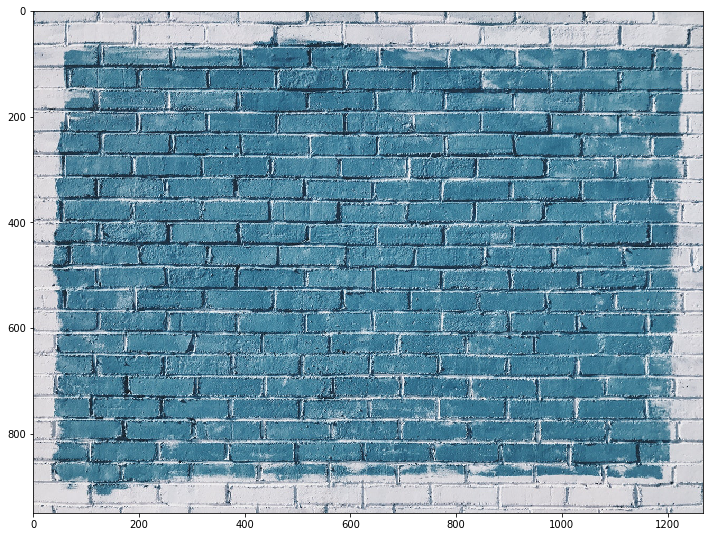

In [171]:
i = load_img()
display_img(i)

### Gamma Correction : Practical Effect of Increasing Brightness

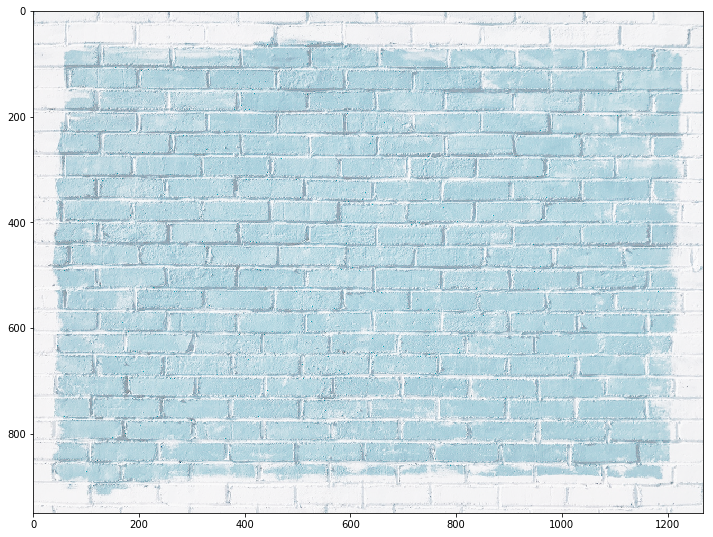

In [173]:
img = load_img()
gamma = 1/4
effected_image = np.power(img, gamma)
display_img(effected_image)

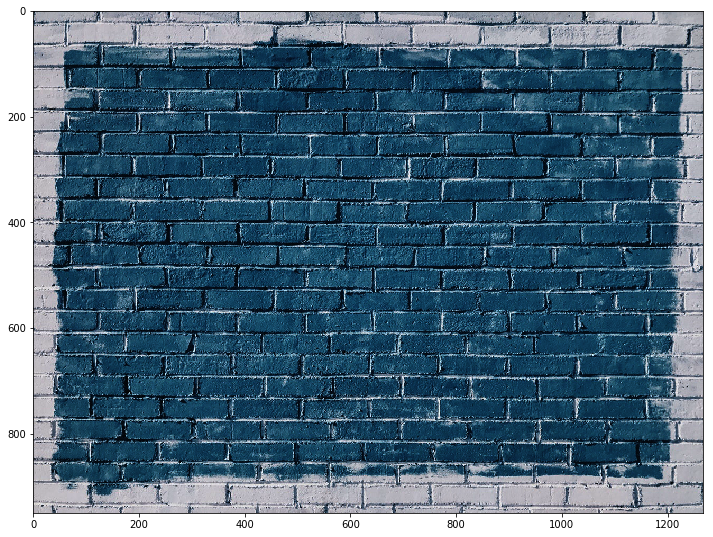

In [174]:
gamma = 2
effected_image = np.power(img, gamma)
display_img(effected_image)

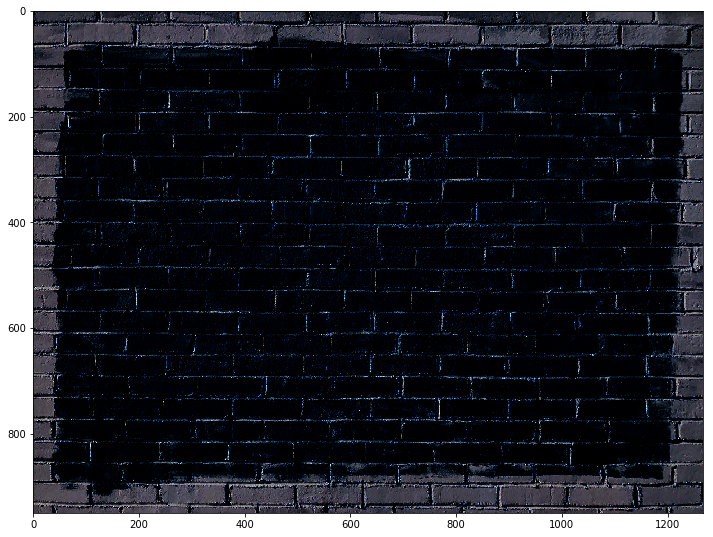

In [175]:
gamma = 8
effected_image = np.power(img, gamma)
display_img(effected_image)

### Low Pass Filter with a 2D Convolution

A fitlering operation known as 2D convolution can be used to create a low-pass filter. Make sure to view the video for an explanation of what's happening in the code below.

In [181]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text = 'Bricks', org = (10, 600), fontFace=font, fontScale = 10, color = (255,255,0), thickness = 4)

array([[[0.7921569 , 0.78431374, 0.8039216 ],
        [0.7529412 , 0.77254903, 0.7882353 ],
        [0.7176471 , 0.76862746, 0.8       ],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.88235295, 0.8784314 , 0.8980392 ],
        [0.75686276, 0.78431374, 0.80784315],
        [0.69803923, 0.75686276, 0.78431374],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       [[0.8627451 , 0.8666667 , 0.8862745 ],
        [0.64705884, 0.68235296, 0.70980394],
        [0.48235294, 0.5372549 , 0.57254905],
        ...,
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ],
        [0.7764706 , 0.76862746, 0.7882353 ]],

       ...,

       [[0.8509804 , 0.83137256, 0.84705883],
        [0.84705883, 0.827451  , 0.84313726],
        [0.84313726, 0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


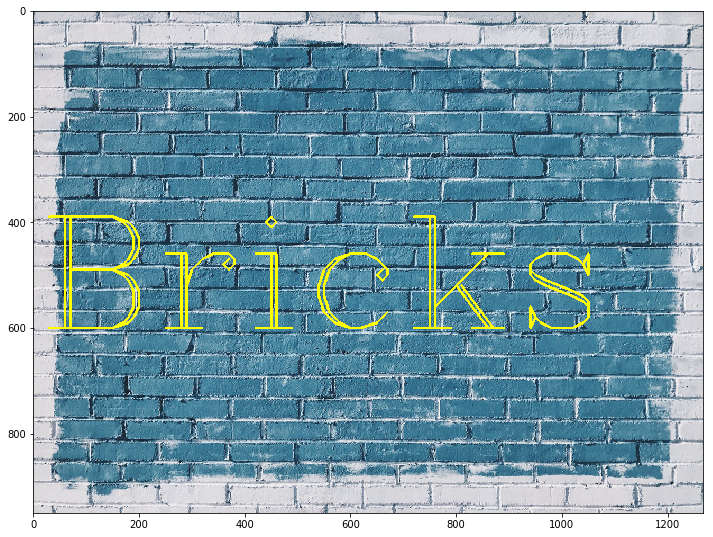

In [182]:
display_img(img)

### Create the Kernel

For more information visit http://setosa.io/ev/image-kernels/

In [184]:
kernel = np.ones(shape=(5,5),dtype=np.float32)/25

In [185]:
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


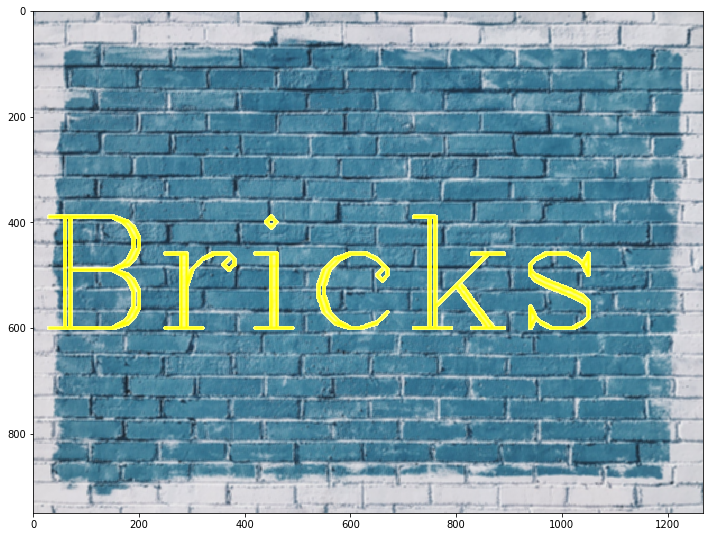

In [186]:
dst = cv2.filter2D(img, -1, kernel)
display_img(dst)

#### Averaging

In [187]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text = 'Bricks', org = (10, 600), fontFace=font, fontScale = 10, color = (255,255,0), thickness = 4)
print('reset')

reset


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


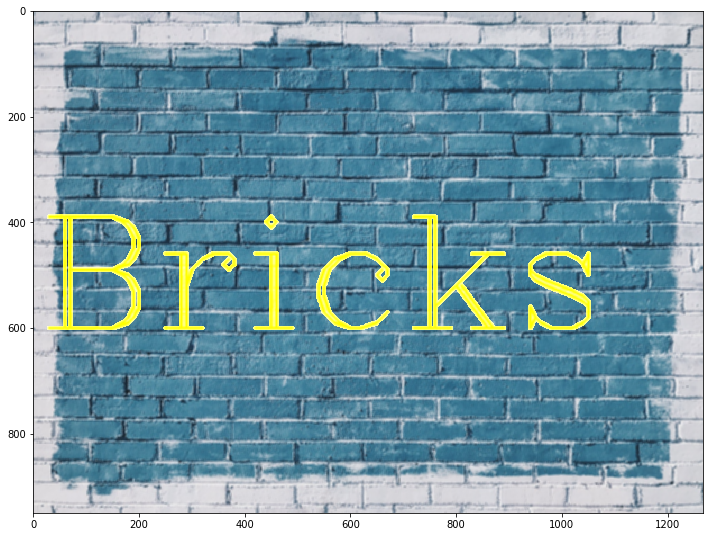

In [188]:
blurred = cv2.blur(img, ksize=(5,5))
display_img(blurred)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


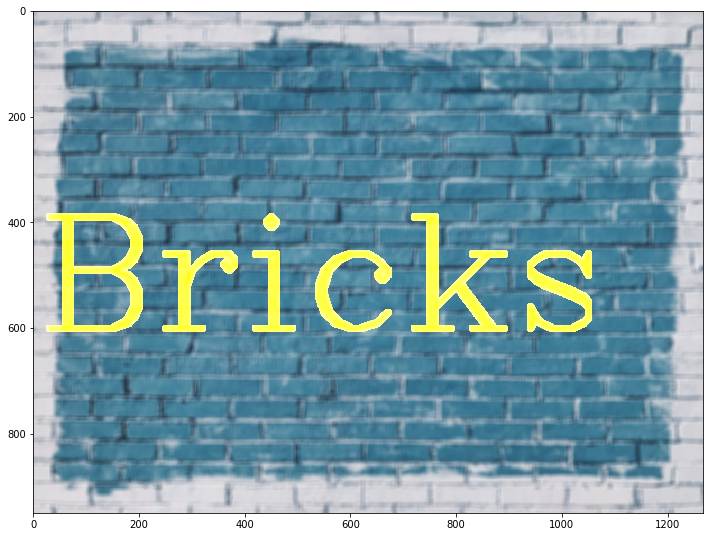

In [189]:
blurred = cv2.blur(img, ksize=(10,10))
display_img(blurred)

In [190]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text = 'Bricks', org = (10, 600), fontFace=font, fontScale = 10, color = (255,255,0), thickness = 4)
print('reset')

reset


### Gaussian Blurring

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


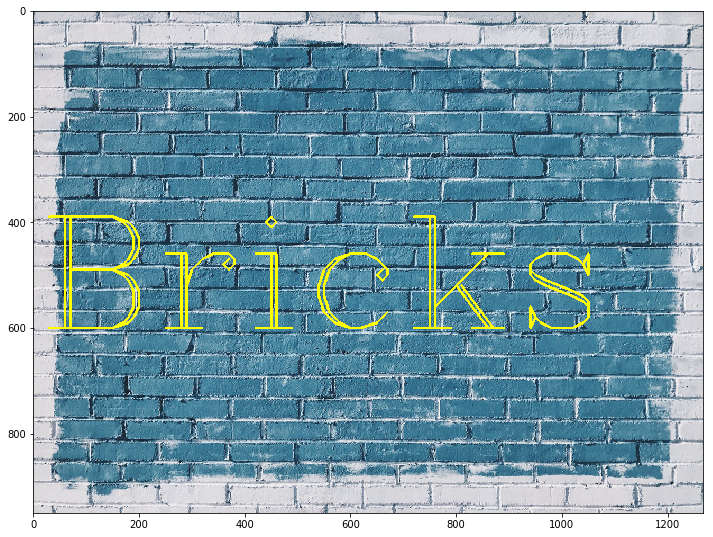

In [191]:
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


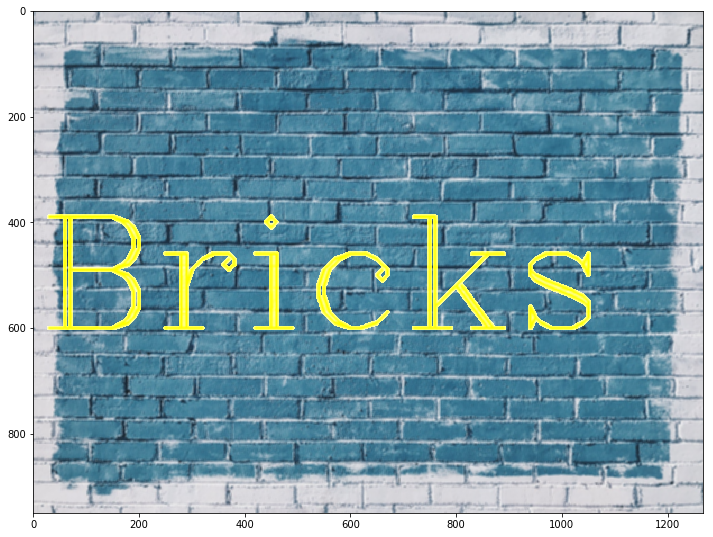

In [192]:
blurred_img = cv2.GaussianBlur(img,(5,5),10)
display_img(blurred_img)

### Median Blurring

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


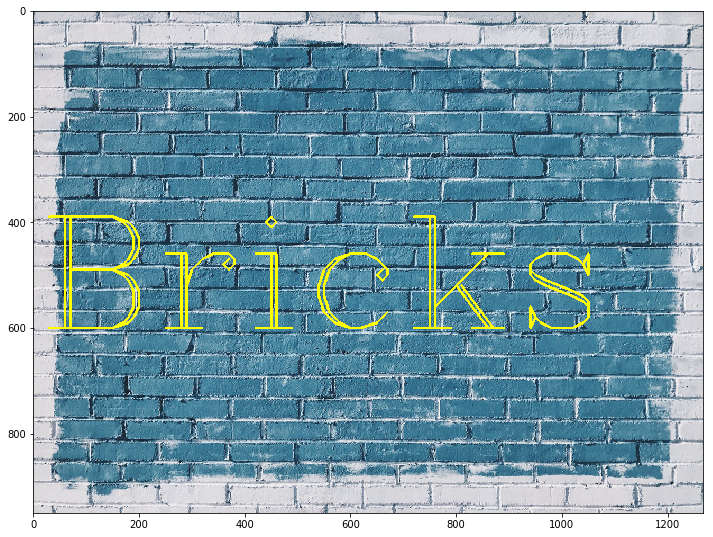

In [193]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text = 'Bricks', org = (10, 600), fontFace=font, fontScale = 10, color = (255,255,0), thickness = 4)
print('reset')
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


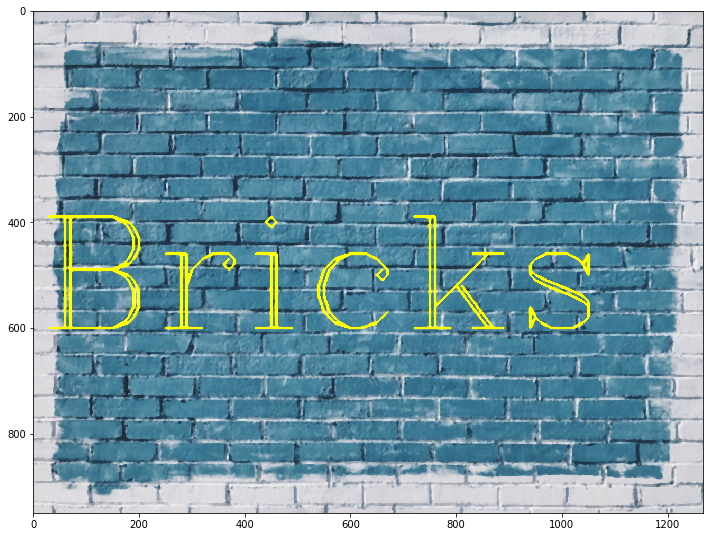

In [194]:
median = cv2.medianBlur(img,5)
display_img(median)


#### Adding Noise

Let's see a more useful case of Median Blurring by adding some random noise to an image.

In [195]:
img = cv2.imread('DATA/sammy.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

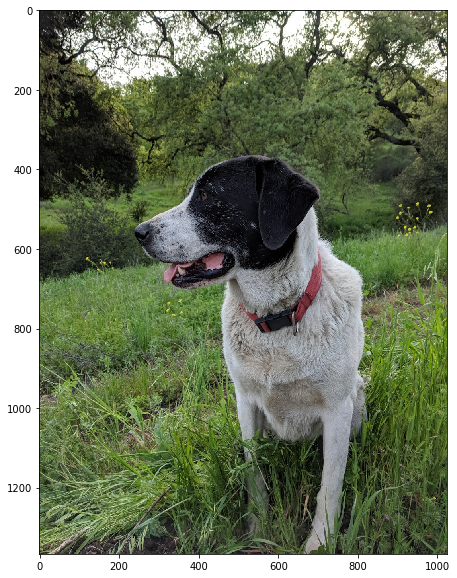

In [196]:
display_img(img)

In [197]:
noise_img  = cv2.imread('DATA/sammy_noise.jpg')

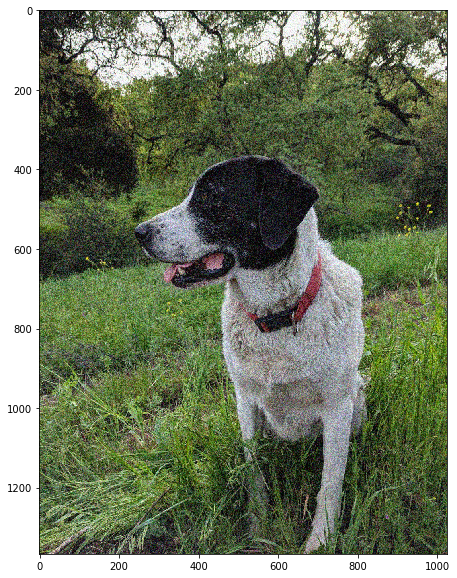

In [198]:
display_img(noise_img)

In [199]:
median = cv2.medianBlur(noise_img, 5)

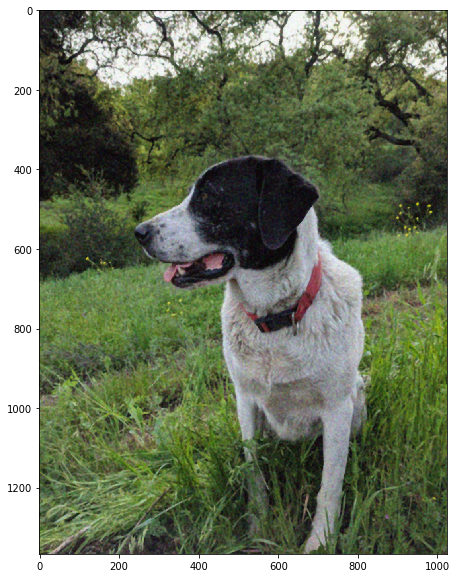

In [200]:
display_img(median)

In [201]:
img.max()

255

In [202]:
img.min()

0

In [203]:
img.mean()

89.33082543817392

In [204]:
img.shape

(1367, 1025, 3)

### Bilateral Filtering

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


reset


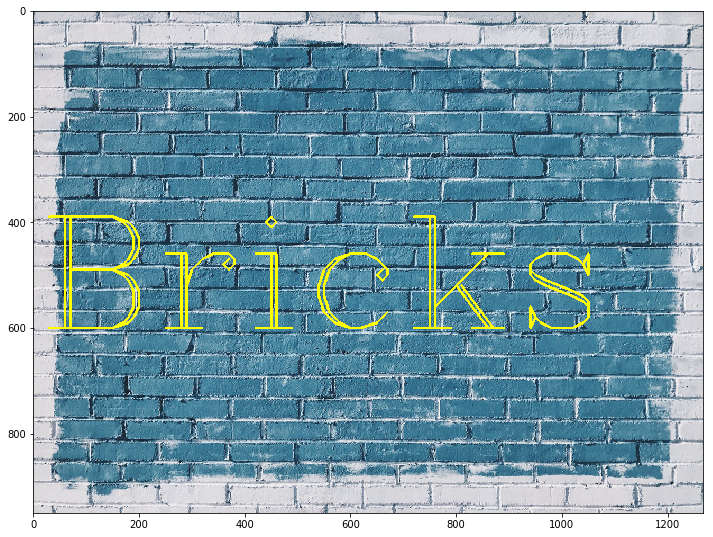

In [205]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img, text = 'Bricks', org = (10, 600), fontFace=font, fontScale = 10, color = (255,255,0), thickness = 4)
print('reset')
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


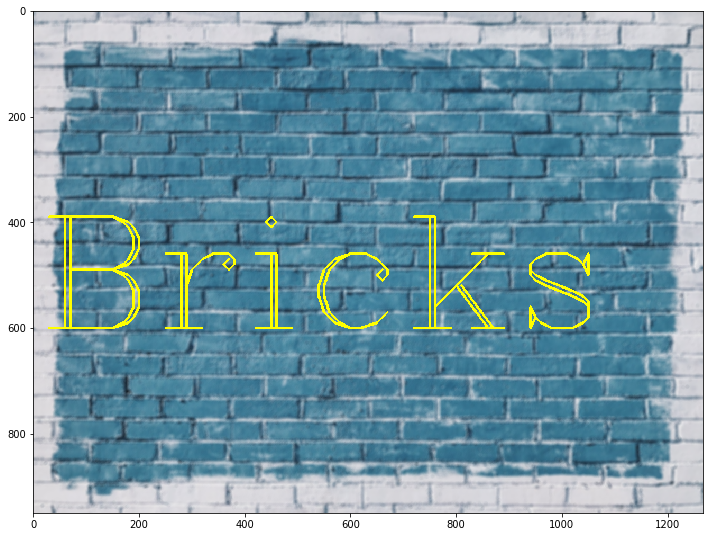

In [206]:
blur = cv2.bilateralFilter(img, 9, 75, 75)
display_img(blur)

-------------

## Morphological Operators

In [207]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [208]:
def load_img():
    blank_img =np.zeros((600,600))
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(blank_img,text='ABCDE',org=(50,300), fontFace=font,fontScale= 5,color=(255,255,255),thickness=25,lineType=cv2.LINE_AA)
    return blank_img

In [209]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

In [210]:
img = load_img()

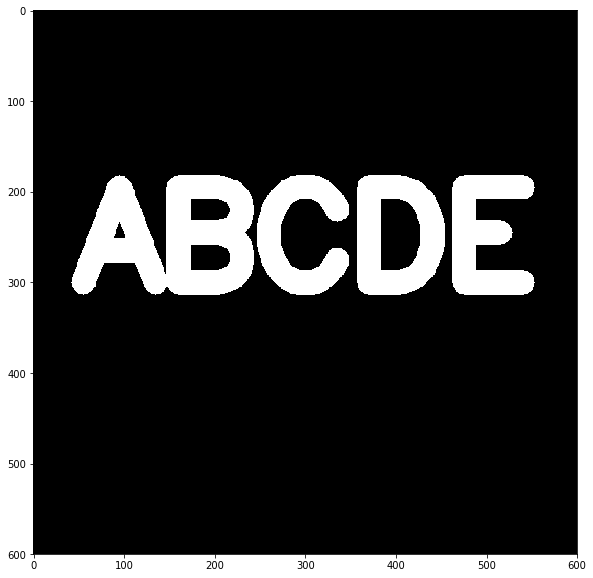

In [211]:
display_img(img)

### Erosion
Erodes away boundaries of foreground objects. Works best when foreground is light color (preferrably white) and background is dark.

In [212]:
kernel = np.ones((5,5),np.uint8)
kernel

array([[1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1],
       [1, 1, 1, 1, 1]], dtype=uint8)

In [213]:
erosion1 = cv2.erode(img,kernel,iterations = 1)

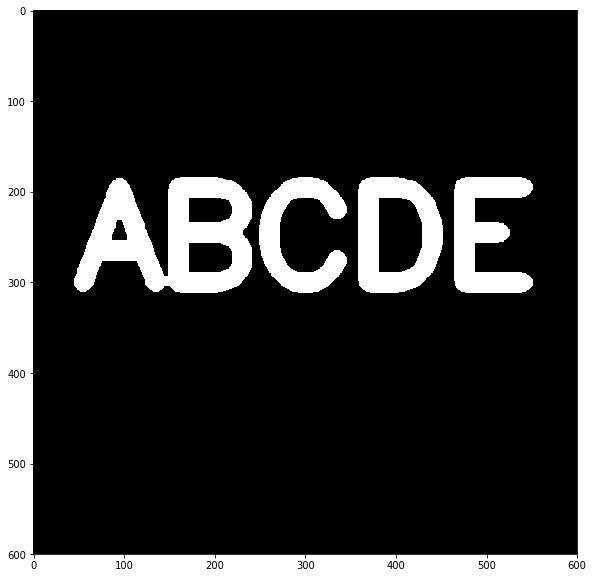

In [214]:
display_img(erosion1)

In [215]:
erosion1 = cv2.erode(img,kernel,iterations = 5)

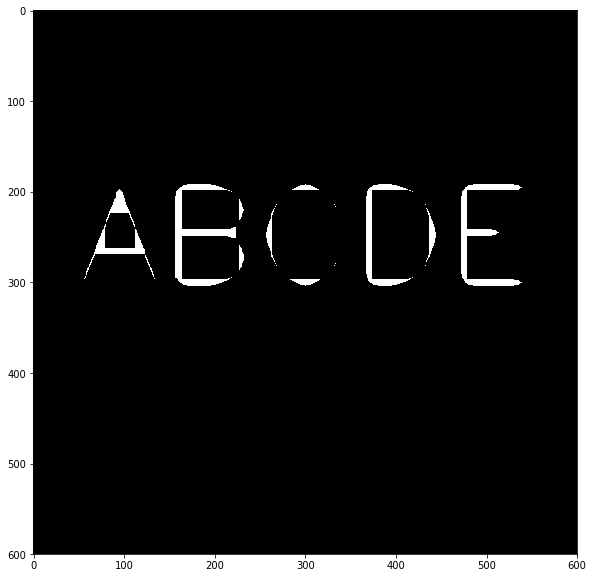

In [216]:
display_img(erosion1)

In [217]:
img = load_img()
kernel = np.ones((5,5),np.uint8)
erosion5 = cv2.erode(img,kernel,iterations = 4)

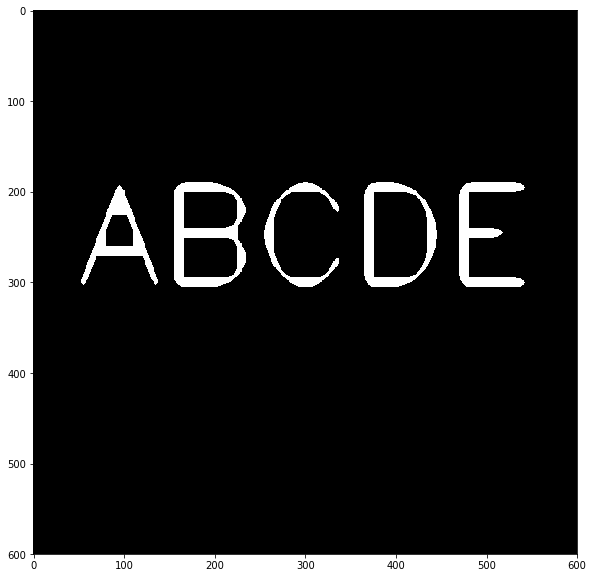

In [218]:
display_img(erosion5)

### Opening
Opening is erosion followed by dilation. Useful in removing background noise!

In [219]:
img = load_img()

In [220]:
white_noise = np.random.randint(low=0,high=2,size=(600,600))

In [221]:
white_noise

array([[0, 1, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 1, 1, 0],
       [1, 1, 0, ..., 0, 0, 0],
       ...,
       [0, 1, 1, ..., 0, 0, 0],
       [1, 0, 0, ..., 1, 1, 0],
       [1, 0, 1, ..., 0, 0, 0]])

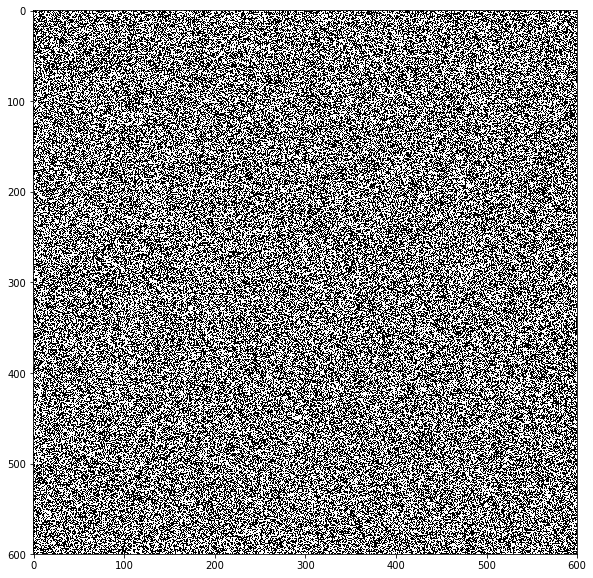

In [222]:
display_img(white_noise)

In [223]:
img.max()

255.0

In [224]:
white_noise = white_noise*255

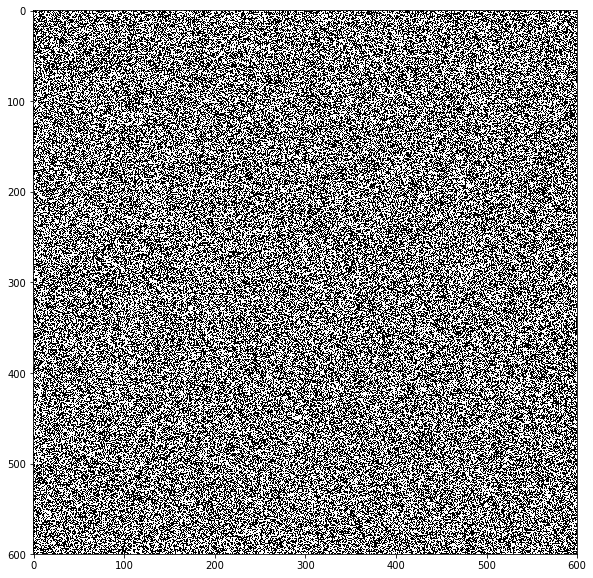

In [225]:
display_img(white_noise)

In [226]:
white_noise.shape

(600, 600)

In [227]:
img.shape

(600, 600)

In [228]:
noise_img = white_noise+img

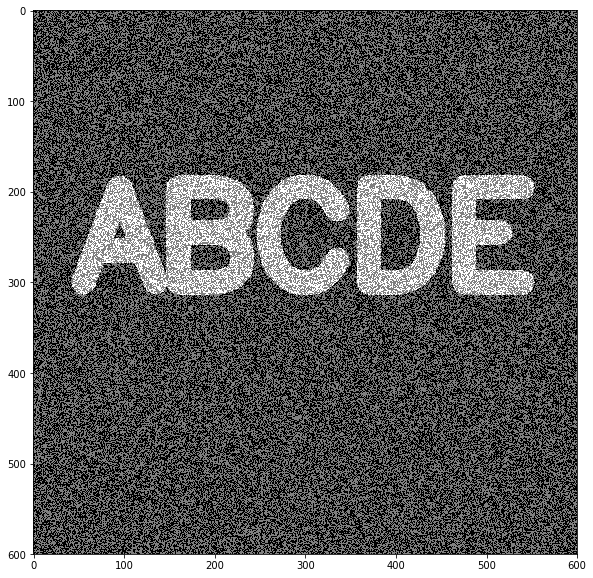

In [229]:
display_img(noise_img)

In [230]:
opening = cv2.morphologyEx(noise_img, cv2.MORPH_OPEN, kernel)

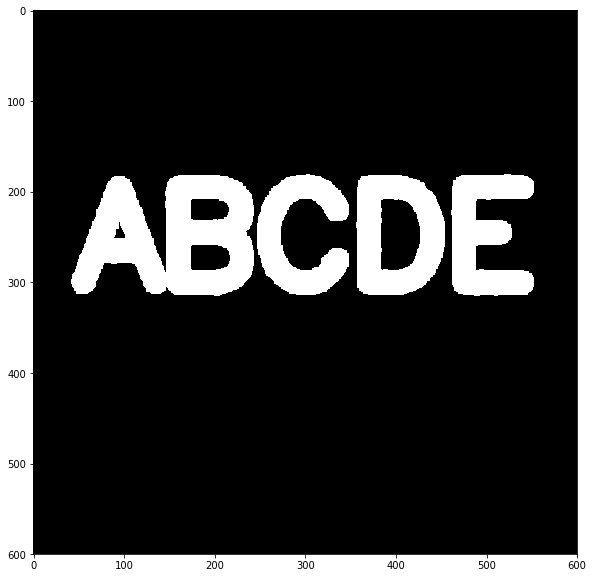

In [231]:
display_img(opening)

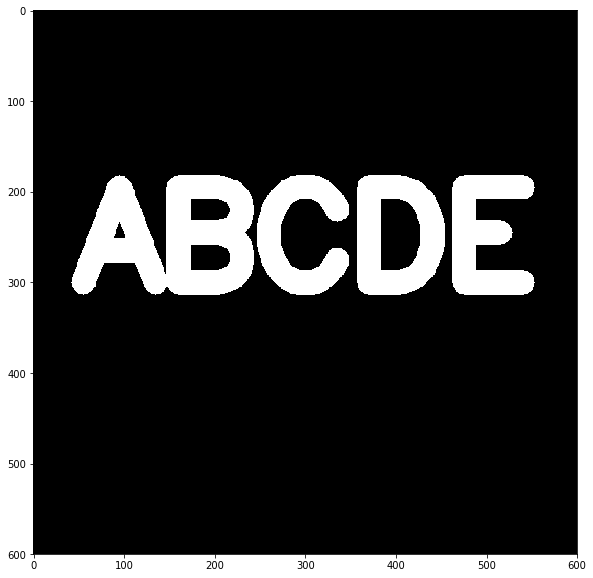

In [232]:
display_img(img)

### Closing
Useful in removing noise from foreground objects, such as black dots on top of the white text.

In [233]:
img = load_img()

In [234]:
black_noise = np.random.randint(low=0,high=2,size=(600,600))

In [235]:
black_noise

array([[1, 1, 0, ..., 1, 0, 1],
       [1, 0, 0, ..., 0, 0, 1],
       [0, 1, 1, ..., 1, 0, 0],
       ...,
       [0, 1, 1, ..., 1, 1, 0],
       [1, 1, 1, ..., 0, 1, 0],
       [0, 0, 1, ..., 0, 1, 0]])

In [236]:
black_noise= black_noise * -255

In [237]:
black_noise_img = img + black_noise

In [238]:
black_noise_img

array([[-255., -255.,    0., ..., -255.,    0., -255.],
       [-255.,    0.,    0., ...,    0.,    0., -255.],
       [   0., -255., -255., ..., -255.,    0.,    0.],
       ...,
       [   0., -255., -255., ..., -255., -255.,    0.],
       [-255., -255., -255., ...,    0., -255.,    0.],
       [   0.,    0., -255., ...,    0., -255.,    0.]])

In [239]:
black_noise_img[black_noise_img==-255] = 0

In [240]:
black_noise_img.min()

0.0

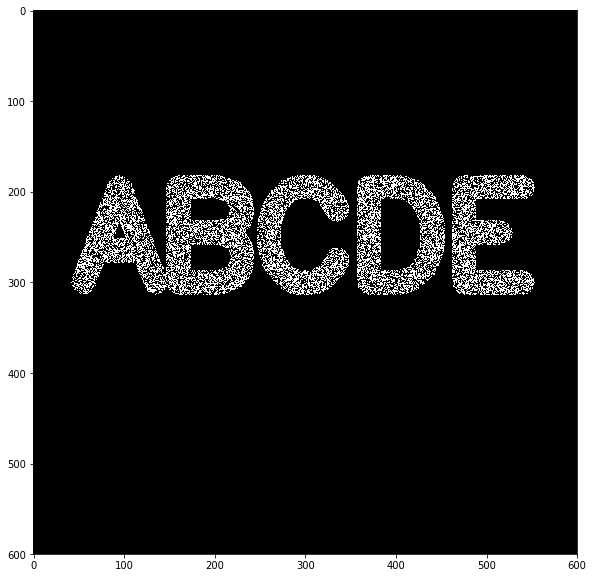

In [241]:
display_img(black_noise_img)

In [242]:
closing = cv2.morphologyEx(black_noise_img, cv2.MORPH_CLOSE, kernel)

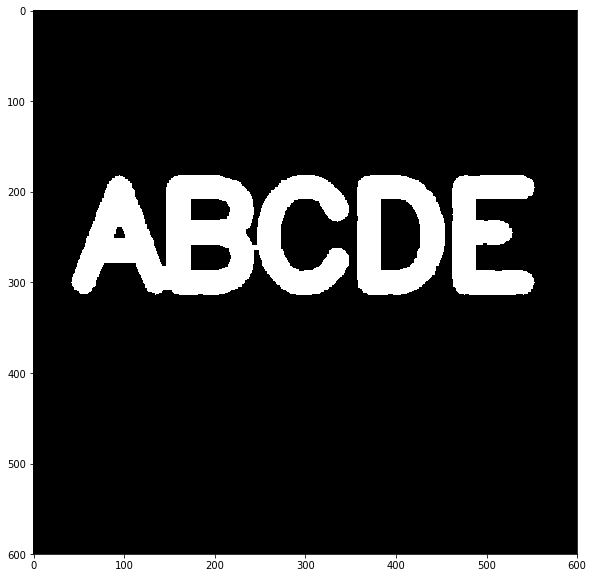

In [243]:
display_img(closing)

### Morphological Gradient

Difference between dilation and erosion of an image.

In [245]:
img = load_img()

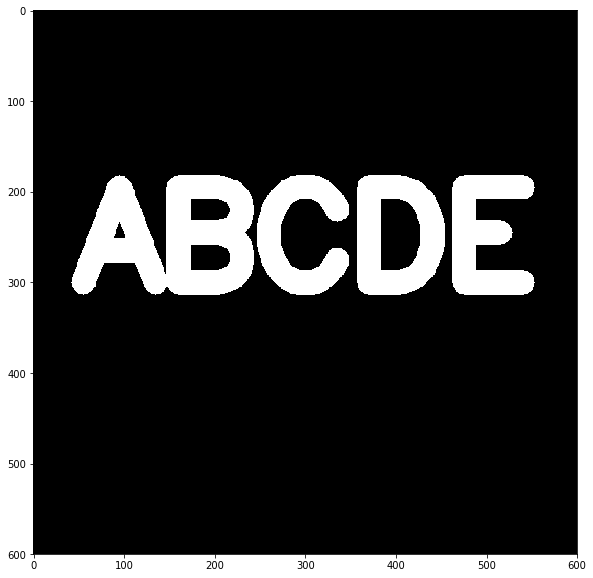

In [246]:
display_img(img)

In [247]:
gradient = cv2.morphologyEx(img,cv2.MORPH_GRADIENT,kernel)

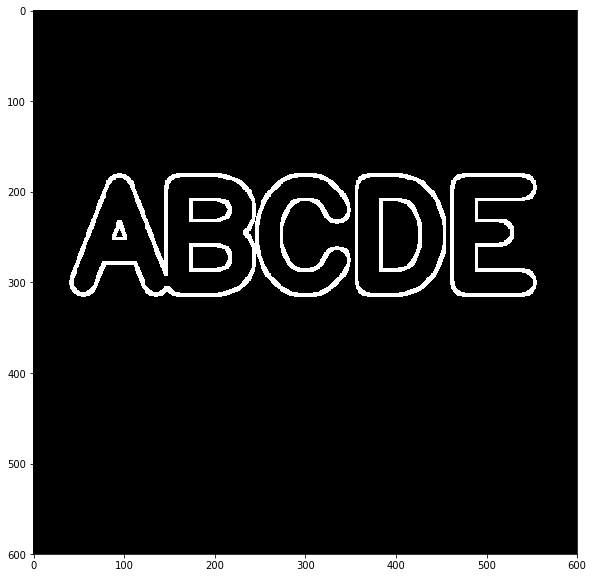

In [248]:
display_img(gradient)

-------------

## Gradients

Understanding gradients will allow us to eventually understand edge detection which we will use later on, since its an important aspect of object detection in general.
Make sure to watch the lecture video for the full overview!

Idea of Sobel Operator: https://en.wikipedia.org/wiki/Sobel_operator

In [249]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [251]:
img = cv2.imread('DATA/sudoku.jpg',0)

In [252]:
def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap='gray')

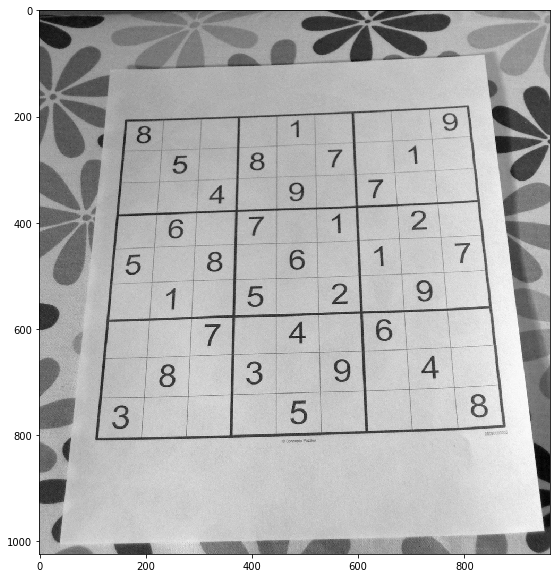

In [253]:
display_img(img)

In [254]:
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)
sobely = cv2.Sobel(img,cv2.CV_64F,0,1,ksize=5)
laplacian = cv2.Laplacian(img,cv2.CV_64F)

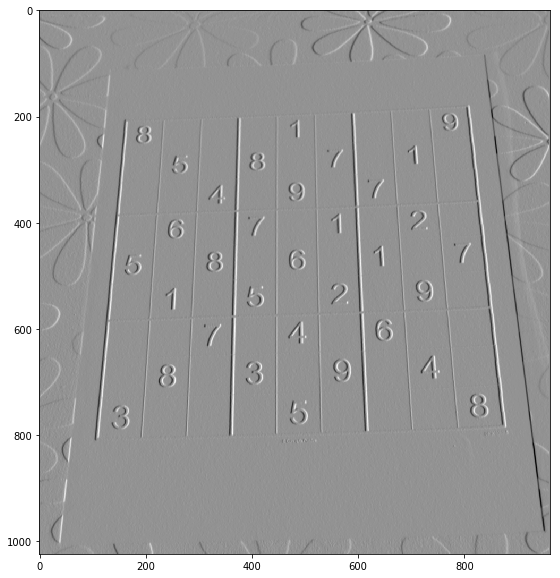

In [255]:
display_img(sobelx)

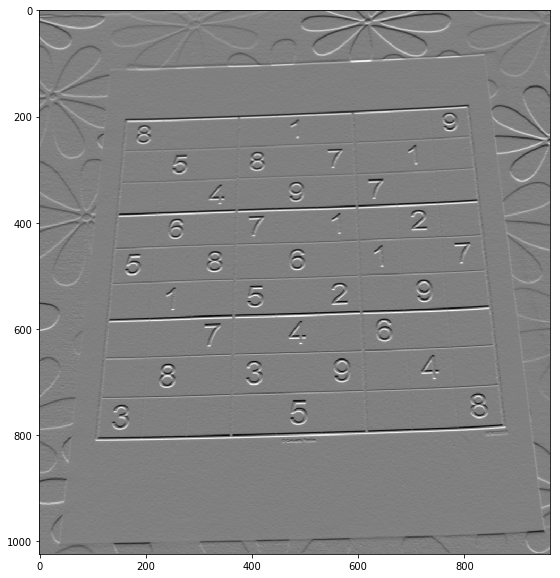

In [256]:
display_img(sobely)

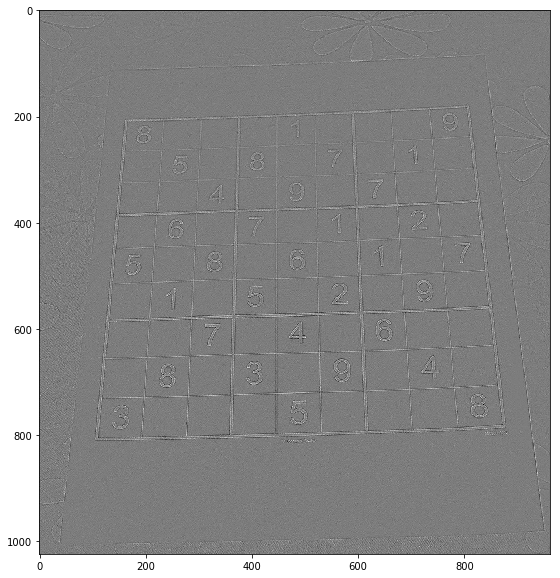

In [257]:
display_img(laplacian)

### Combining Previous Ideas

Let's play around with these images with some of the other ideas we've already seen!

#### Blending Images

In [258]:
blended = cv2.addWeighted(src1=sobelx,alpha=0.5,src2=sobely,beta=0.5,gamma=0)

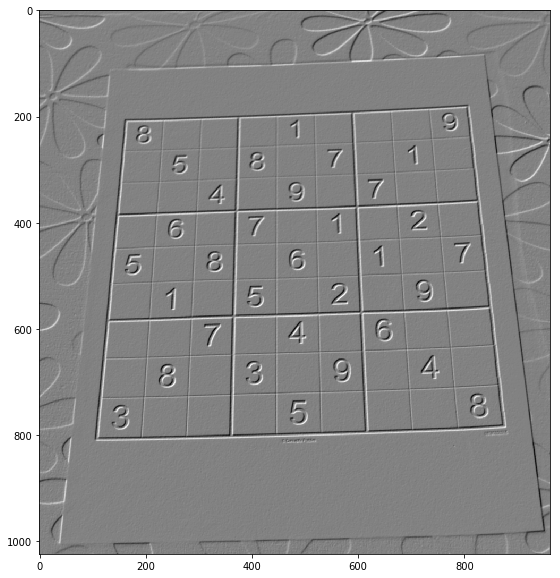

In [259]:
display_img(blended)

In [260]:
blended.shape

(1024, 962)

#### Morphological Operators

In [261]:
kernel = np.ones((4,4),np.uint8)
gradient = cv2.morphologyEx(blended,cv2.MORPH_GRADIENT,kernel)

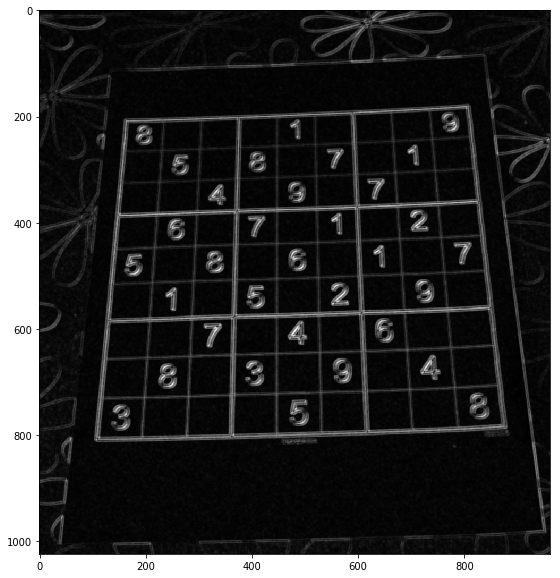

In [262]:
display_img(gradient)

Try it on the laplacian result!

In [263]:
kernel = np.ones((3,3),np.uint8)
gradient = cv2.morphologyEx(blended,cv2.MORPH_GRADIENT,kernel)

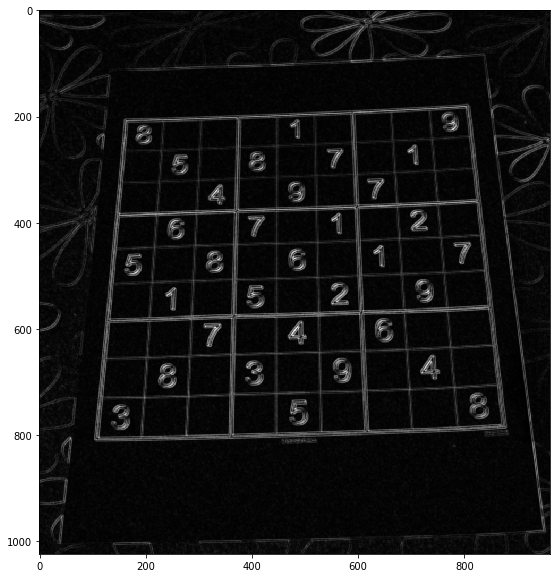

In [264]:
display_img(gradient)

#### Thresholds

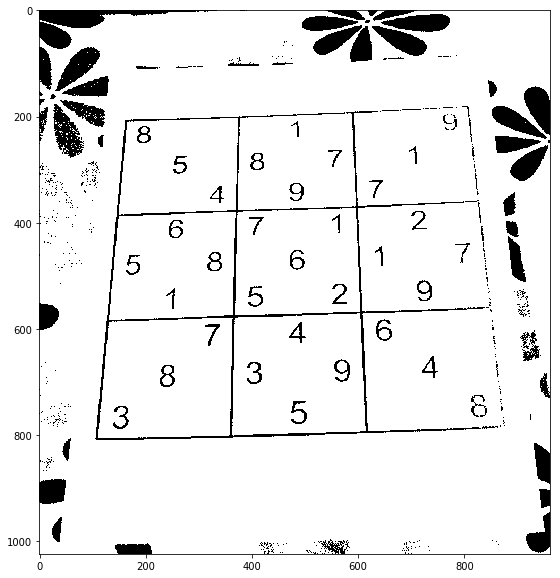

In [265]:
ret,th1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
display_img(th1)

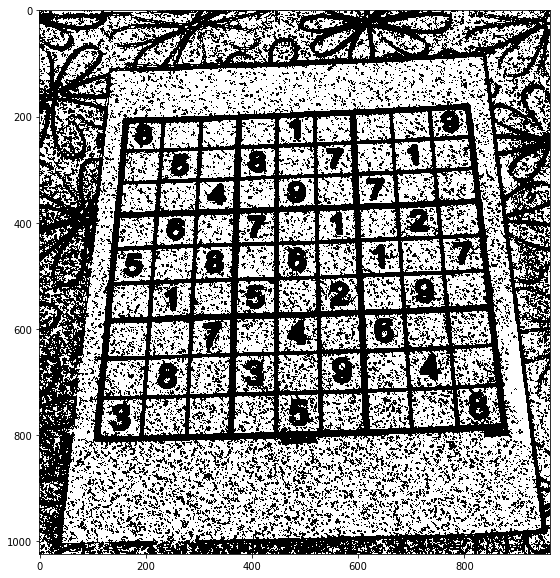

In [266]:
ret,th1 = cv2.threshold(gradient,200,255,cv2.THRESH_BINARY_INV)
display_img(th1)

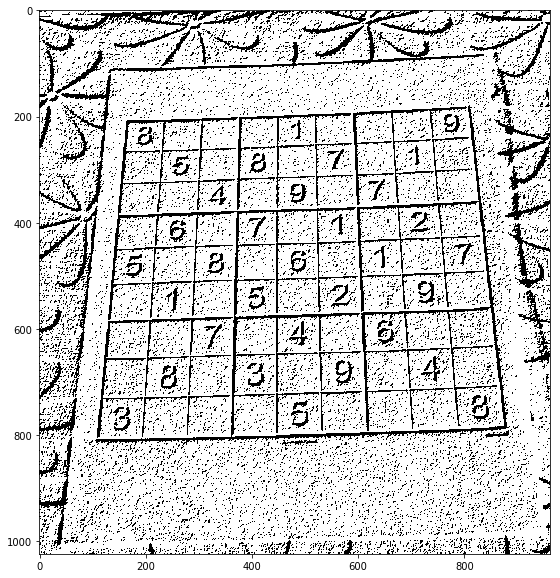

In [267]:
ret,th1 = cv2.threshold(blended,100,255,cv2.THRESH_BINARY_INV)
display_img(th1)

--------

## Histograms

Check out the video for full details, but here is also a great write-up: http://www.cambridgeincolour.com/tutorials/histograms1.htm

In [268]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

### Image Histograms with OpenCV
Recall that Matplotlib expects the images in a different RGB ordering vs BGR in OpenCV, so if we use OpenCV to calculate anything channel oriented, we'll want to make sure we keep the original RGB ordering, however if we ever want to display the image, then we'll need to convert to the RGB ordering that matplotlib wants.

In [269]:
dark_horse = cv2.imread('DATA/horse.jpg')
show_horse = cv2.cvtColor(dark_horse, cv2.COLOR_BGR2RGB)

rainbow = cv2.imread('DATA/rainbow.jpg')
show_rainbow =cv2.cvtColor(rainbow, cv2.COLOR_BGR2RGB)

blue_bricks = cv2.imread('DATA/bricks.jpg')
show_bricks = cv2.cvtColor(blue_bricks, cv2.COLOR_BGR2RGB)

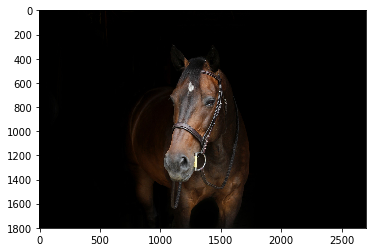

In [270]:
plt.imshow(show_horse)

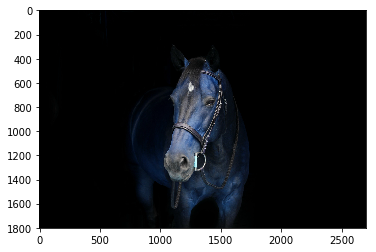

In [271]:
# RECALL MATPLOTLIB IMSHOW EXPECTS THE RGB IN A DIFFERENT ORDER!
# WATCH VIDEO FOR FULL DETAILS PLEASE!
plt.imshow(dark_horse)

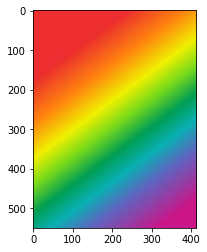

In [272]:
plt.imshow(show_rainbow)

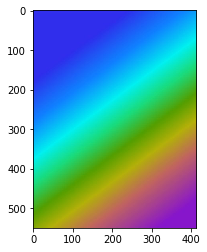

In [273]:
plt.imshow(rainbow)

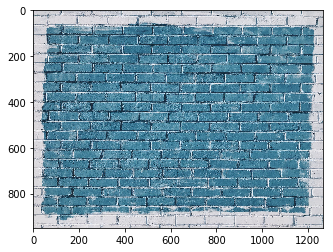

In [274]:
plt.imshow(show_bricks)

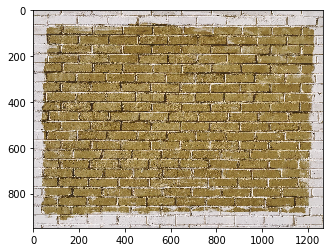

In [275]:
plt.imshow(blue_bricks)

#### OpenCV Histogram

**cv2.calcHist(images, channels, mask, histSize, ranges[, hist[, accumulate]])**

* images : it is the source image of type uint8 or float32. it should be given in square brackets, ie, “[img]”.
* channels : it is also given in square brackets. It is the index of channel for which we calculate histogram. For example, if input is grayscale image, its value is [0]. For color image, you can pass [0], [1] or [2] to calculate histogram of blue, green or red channel respectively.
* mask : mask image. To find histogram of full image, it is given as “None”. But if you want to find histogram of particular region of image, you have to create a mask image for that and give it as mask. (I will show an example later.)
* histSize : this represents our BIN count. Need to be given in square brackets. For full scale, we pass [256].
* ranges : this is our RANGE. Normally, it is [0,256].

In [276]:
# OPENCV BGR
hist_values = cv2.calcHist([blue_bricks], channels = [0], mask = None, histSize = [256], ranges = [0, 256])

In [277]:
hist_values.shape

(256, 1)

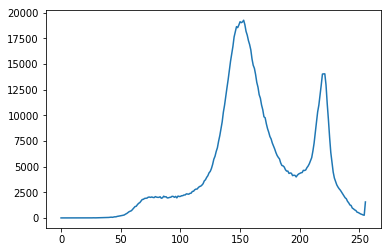

In [279]:
plt.plot(hist_values)

In [280]:
hist_values = cv2.calcHist([dark_horse],channels=[0],mask=None,histSize=[256],ranges=[0,256])

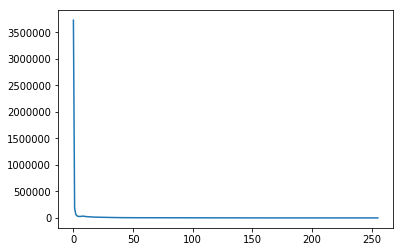

In [281]:
plt.plot(hist_values)

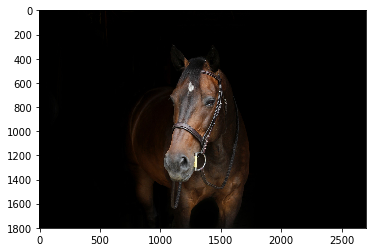

In [282]:
plt.imshow(show_horse)

### Plotting 3 Color Histograms

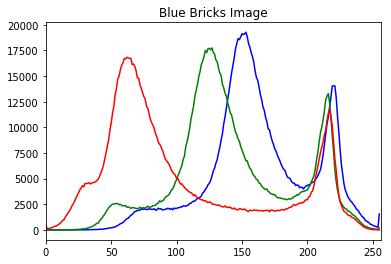

In [283]:
img = blue_bricks
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Blue Bricks Image')
plt.show()

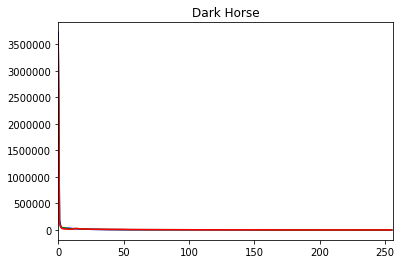

In [284]:
img = dark_horse
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Dark Horse')
plt.show()

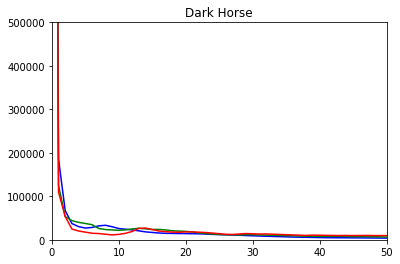

In [286]:
img = dark_horse
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,50])
    plt.ylim([0,500000])
plt.title('Dark Horse')
plt.show()

In [288]:
dark_horse.shape

(1800, 2700, 3)

In [289]:
1800*2700*3

14580000

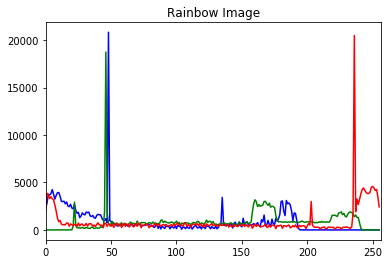

In [290]:
img = rainbow
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Rainbow Image')
plt.show()

#### Masking

We can mask only certain parts of the image.

In [291]:
img = rainbow

In [292]:
img.shape

(550, 413, 3)

In [293]:
# create a mask
mask = np.zeros(img.shape[:2], np.uint8)
mask[300:400, 100:400] = 255

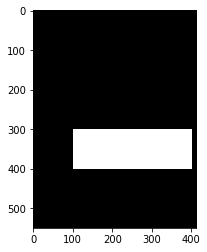

In [294]:
plt.imshow(mask,cmap='gray')

In [295]:
masked_img = cv2.bitwise_and(img,img,mask = mask)
show_masked_img = cv2.bitwise_and(show_rainbow,show_rainbow,mask = mask)

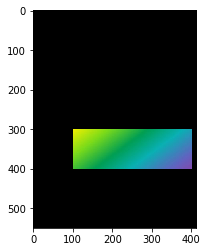

In [296]:
plt.imshow(show_masked_img)

In [297]:
hist_mask_values_red = cv2.calcHist([rainbow],channels=[2],mask=mask,histSize=[256],ranges=[0,256])
hist_full_values_red = cv2.calcHist([rainbow],channels=[2],mask=None,histSize=[256],ranges=[0,256])

Text(0.5,1,'Histogram for RED values of the masked image')

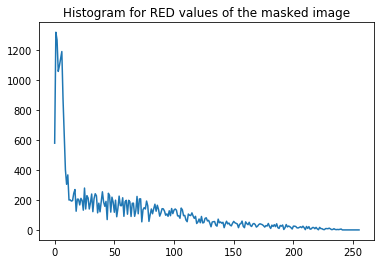

In [300]:
plt.plot(hist_mask_values_red)
plt.title('Histogram for RED values of the masked image')

Text(0.5,1,'Histogram for RED values of the full image')

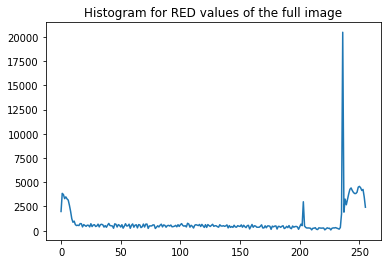

In [301]:
plt.plot(hist_full_values_red)
plt.title('Histogram for RED values of the full image')

### Histogram Equalization

Make sure to watch the video and also read: https://en.wikipedia.org/wiki/Histogram_equalization

In [302]:
gorilla = cv2.imread('DATA/gorilla.jpg',0)

In [303]:
def display(img,cmap=None):
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap)

### Single Channel (Grayscale)

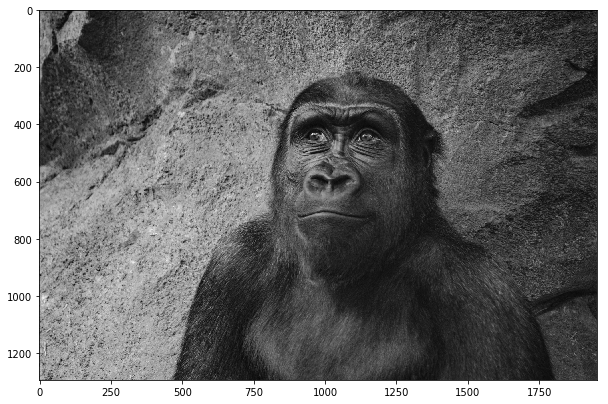

In [304]:
display(gorilla,cmap='gray')

In [305]:
gorilla.shape

(1295, 1955)

In [306]:
hist_values = cv2.calcHist([gorilla], channels = [0], mask = None, histSize = [256], ranges = [0, 256])

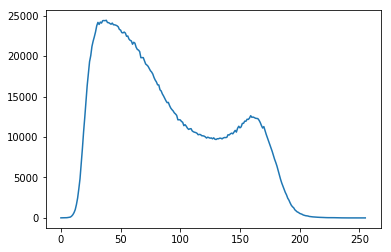

In [307]:
plt.plot(hist_values)

In [308]:
eq_gorilla = cv2.equalizeHist(gorilla)

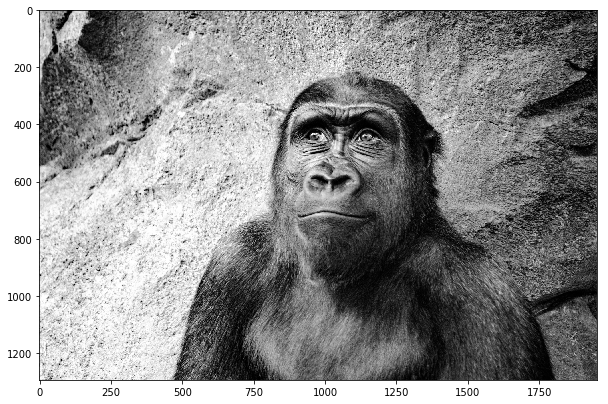

In [309]:
display(eq_gorilla,cmap='gray')

In [310]:
hist_values = cv2.calcHist([eq_gorilla],channels=[0],mask=None,histSize=[256],ranges=[0,256])

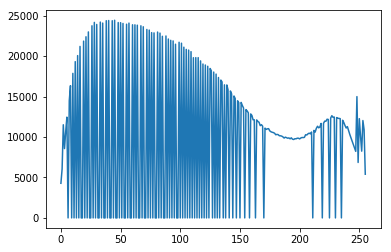

In [311]:
plt.plot(hist_values)

### Color Images

In [312]:
color_gorilla = cv2.imread('DATA/gorilla.jpg')
show_gorilla = cv2.cvtColor(color_gorilla,cv2.COLOR_BGR2RGB)
# Convert to HSV colorspace
hsv = cv2.cvtColor(color_gorilla, cv2.COLOR_BGR2HSV)

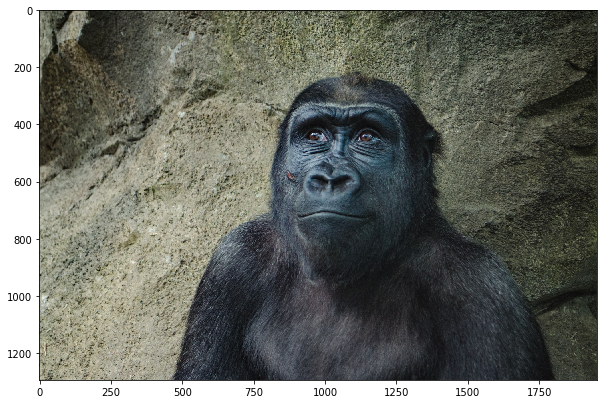

In [313]:
display(show_gorilla)

In [314]:
# Grab V channel
hsv[:,:,2]

array([[127, 121, 115, ...,  43,  42,  42],
       [121, 124, 123, ...,  47,  49,  51],
       [118, 129, 131, ...,  47,  50,  53],
       ...,
       [196, 197, 184, ...,  55,  55,  55],
       [184, 185, 182, ...,  51,  52,  53],
       [173, 170, 173, ...,  49,  50,  50]], dtype=uint8)

In [315]:
hsv[:,:,2] = cv2.equalizeHist(hsv[:,:,2])

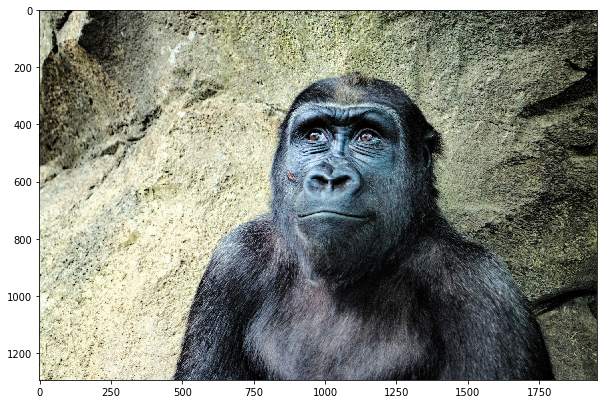

In [316]:
# Convert back to RGB to visualize
eq_color_gorilla = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)
display(eq_color_gorilla)

--------------

# Image Processing Assessment

Complete the tasks in bold below! Feel free to treat this as a code along by skipping this assessment lecture and moving straight to the solutions lecture!

In [11]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

In [12]:
def display_img(img,cmap=None):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img,cmap)

**TASK: Open and display the giaraffes.jpg image that is located in the DATA folder.**

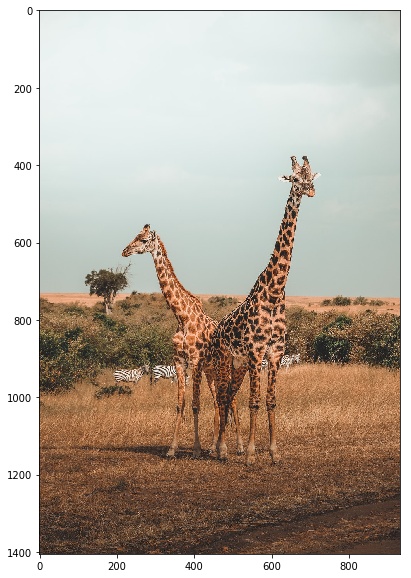

In [13]:
img = cv2.imread('DATA/giraffes.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
display_img(img)

**TASK:Apply a binary threshold onto the image. Note: What happens when you run this on a non grayscale image vs a grayscale image?**

In [14]:
ret,thresh1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)

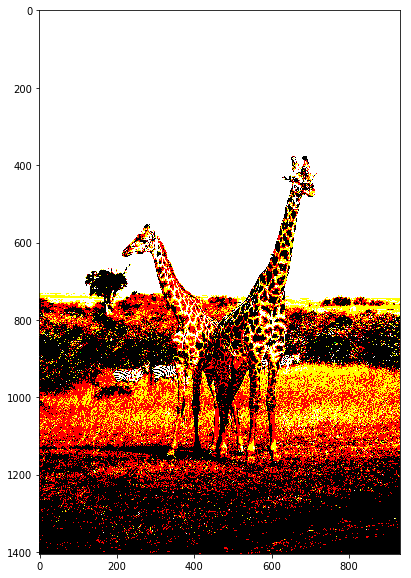

In [15]:
display_img(thresh1)

In [18]:
img = cv2.imread('DATA/giraffes.jpg',0)
ret,thresh1 = cv2.threshold(img,127,255,cv2.THRESH_BINARY)

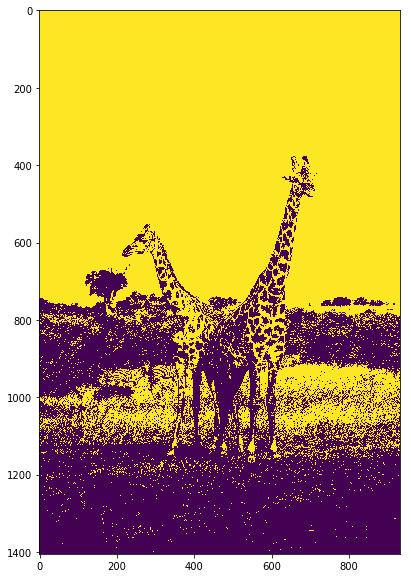

In [19]:
display_img(thresh1)

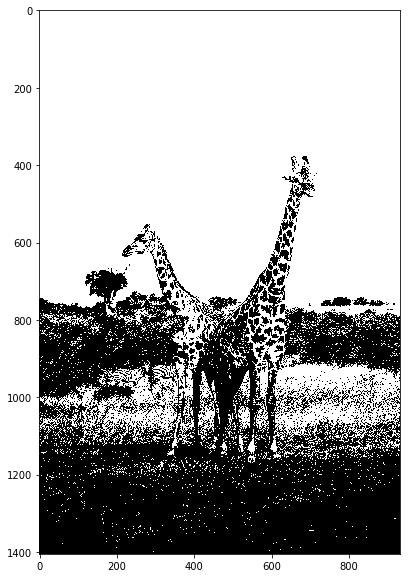

In [20]:
display_img(thresh1, cmap = 'gray')

**TASK: Open the giaraffes.jpg file from the DATA folder and convert its colorspace to  HSV and display the image.**

In [22]:
img = cv2.imread('DATA/giraffes.jpg')

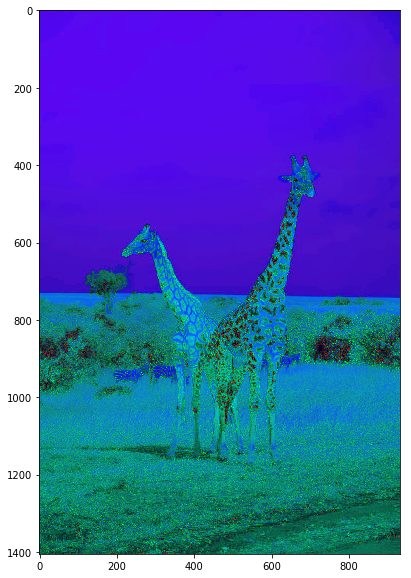

In [23]:
img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
display_img(img)

**TASK: Create a low pass filter with a 4 by 4 Kernel filled with values of 1/10 (0.01) and then use 2-D Convolution to blur the giraffer image (displayed in normal RGB)**

In [24]:
kernel = np.ones(shape=(4,4),dtype=np.float32)/10

In [25]:
kernel

array([[0.1, 0.1, 0.1, 0.1],
       [0.1, 0.1, 0.1, 0.1],
       [0.1, 0.1, 0.1, 0.1],
       [0.1, 0.1, 0.1, 0.1]], dtype=float32)

In [26]:
img = cv2.imread('DATA/giraffes.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

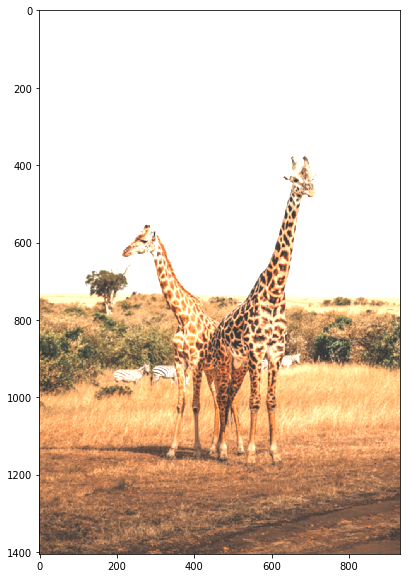

In [28]:
result = cv2.filter2D(img, -1, kernel)
display_img(result)

**TASK: Create a Horizontal Sobel Filter (sobelx from our lecture) with a kernel size of 5 to the grayscale version of the giaraffes image and then display the resulting gradient filtered version of the image.**

In [29]:
img = cv2.imread('DATA/giraffes.jpg',0)

In [30]:
sobelx = cv2.Sobel(img,cv2.CV_64F,1,0,ksize=5)

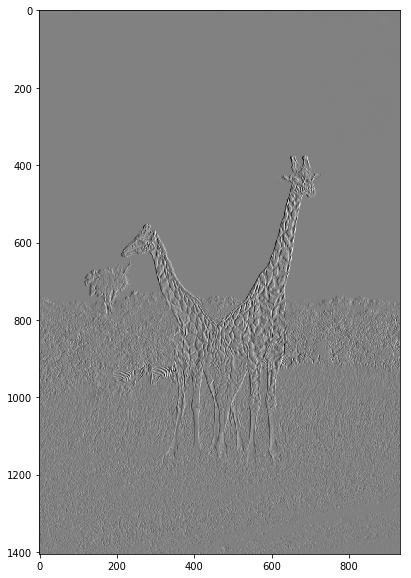

In [31]:
display_img(sobelx,cmap='gray')

**TASK: Plot the color histograms for the RED, BLUE, and GREEN channel of the giaraffe image. Pay careful attention to the ordering of the channels.**

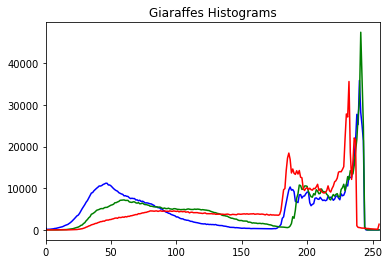

In [32]:
img =cv2.imread('DATA/giraffes.jpg')
color = ('b','g','r')
for i,col in enumerate(color):
    histr = cv2.calcHist([img],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Giaraffes Histograms')
plt.show()

In [34]:
hsv1 = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
hsv1[:,:,2] = cv2.equalizeHist(hsv1[:,:,2])

eq_giraffe = cv2.cvtColor(hsv1, cv2.COLOR_HSV2RGB)

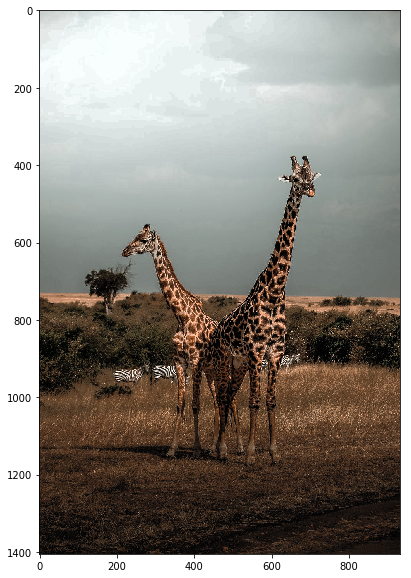

In [35]:
display_img(eq_giraffe)

------------
------------